In [1]:
import zipfile
import h5py
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, f1_score, recall_score
import tensorflow as tf
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input, decode_predictions
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.regularizers import l2
from keras.utils import to_categorical

%matplotlib inline
np.random.seed(42)

In [2]:
# Parameter
IMAGE_WIDTH = 224
IMAGE_HEIGHT = 224
COLOR_CHANNELS = 3
BATCH_SIZE = 32
EPOCHS = 25
K = 5  # Jumlah fold

In [6]:
test_dir = '../../Dataset_Testing'

# Preprocessing data testing
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    shuffle=False  # Agar urutan gambar tetap sama untuk semua model
)

# Evaluasi tiap model per fold
num_folds = 4  # Jumlah fold
models = [f"Skenario_{i+1}.h5" for i in range(num_folds)]

for i, model_path in enumerate(models):
    print(f"\n🔹 Evaluating Skenario {i+1}: {model_path}")
    
    # Load model
    model = tf.keras.models.load_model(model_path)
    
    # Evaluasi model
    loss, accuracy = model.evaluate(test_generator, verbose=1)
    
    # Tampilkan hasil evaluasi
    print(f"✅ Skenario {i+1}: Loss = {loss:.4f}, Accuracy = {accuracy:.4f}")


Found 210 images belonging to 7 classes.

🔹 Evaluating Skenario 1: Skenario_1.h5


7/7 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step - accuracy: 0.8135 - loss: 1.8890
✅ Skenario 1: Loss = 1.7124, Accuracy = 0.8143

🔹 Evaluating Skenario 2: Skenario_2.h5


7/7 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step - accuracy: 0.9267 - loss: 0.2211
✅ Skenario 2: Loss = 0.1938, Accuracy = 0.9238

🔹 Evaluating Skenario 3: Skenario_3.h5


7/7 ━━━━━━━━━━━━━━━━━━━━ 11s 1s/step - accuracy: 0.7147 - loss: 2.9656
✅ Skenario 3: Loss = 1.5334, Accuracy = 0.8476

🔹 Evaluating Skenario 4: Skenario_4.h5


7/7 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.9480 - loss: 0.1430
✅ Skenario 4: Loss = 0.1481, Accuracy = 0.9476


Evaluasi Skenario 1

7/7 ━━━━━━━━━━━━━━━━━━━━ 9s 1s/step  


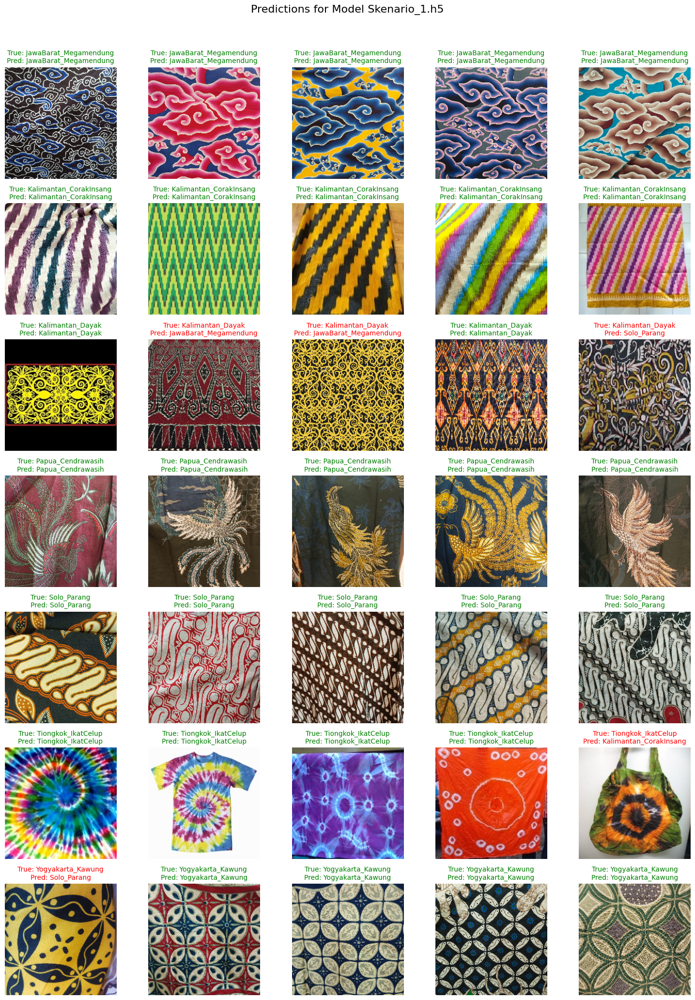

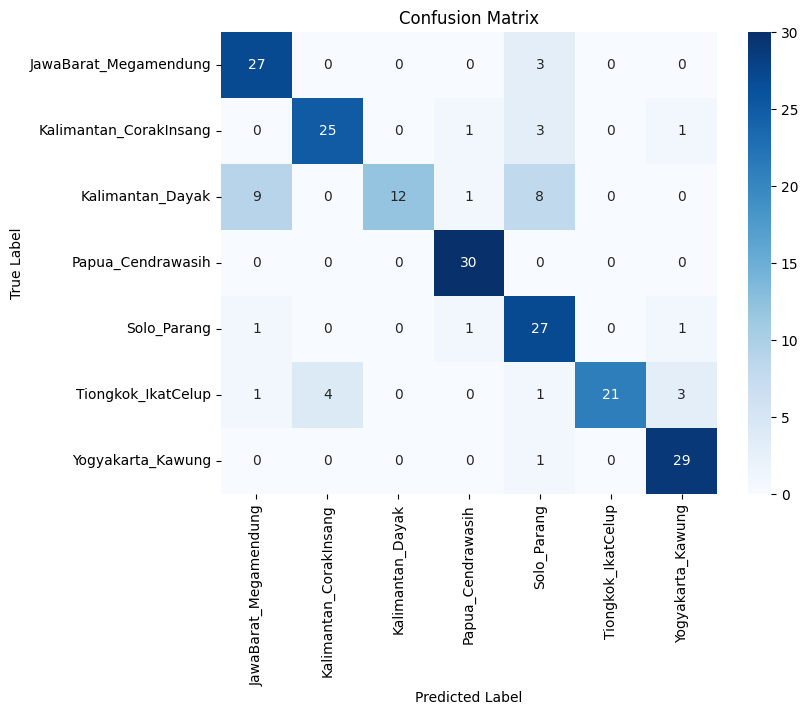

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.71      0.90      0.79        30
Kalimantan_CorakInsang       0.86      0.83      0.85        30
      Kalimantan_Dayak       1.00      0.40      0.57        30
     Papua_Cendrawasih       0.91      1.00      0.95        30
           Solo_Parang       0.63      0.90      0.74        30
    Tiongkok_IkatCelup       1.00      0.70      0.82        30
     Yogyakarta_Kawung       0.85      0.97      0.91        30

              accuracy                           0.81       210
             macro avg       0.85      0.81      0.80       210
          weighted avg       0.85      0.81      0.80       210



In [7]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Skenario_1.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_19480\891105768.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


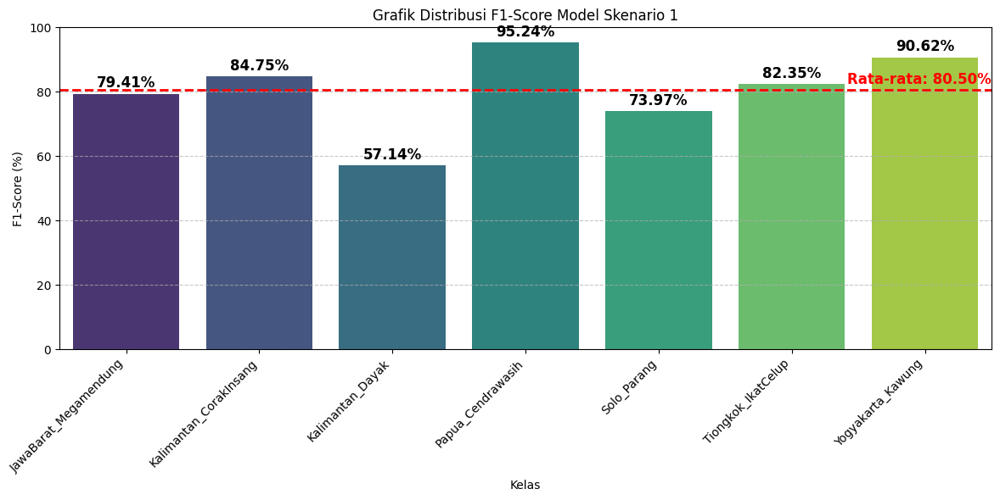

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model Skenario 1")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Skenario 2

7/7 ━━━━━━━━━━━━━━━━━━━━ 9s 1s/step


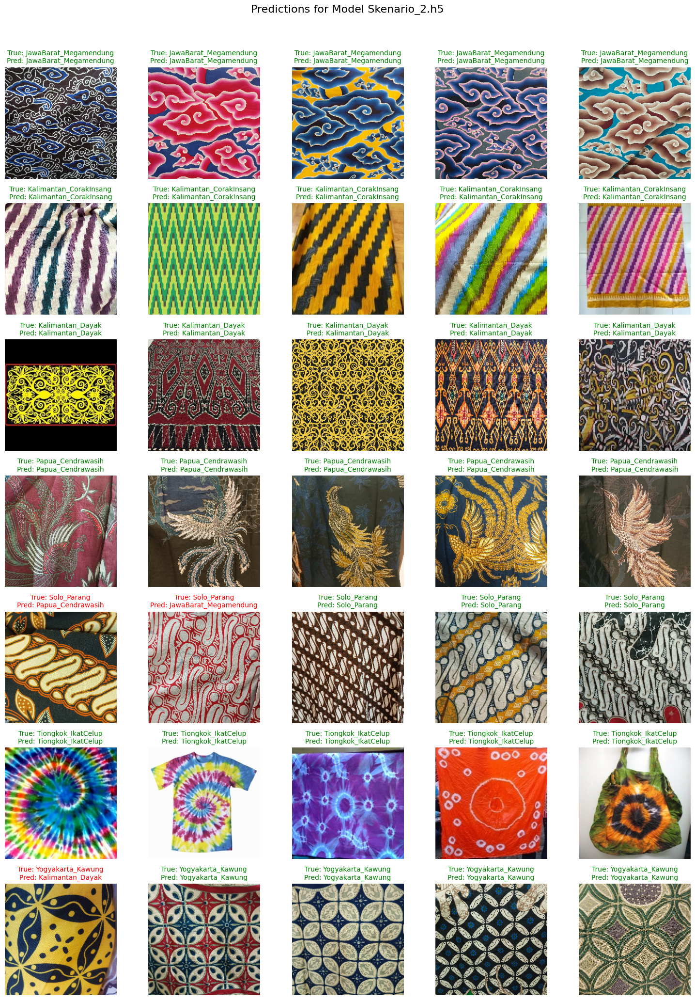

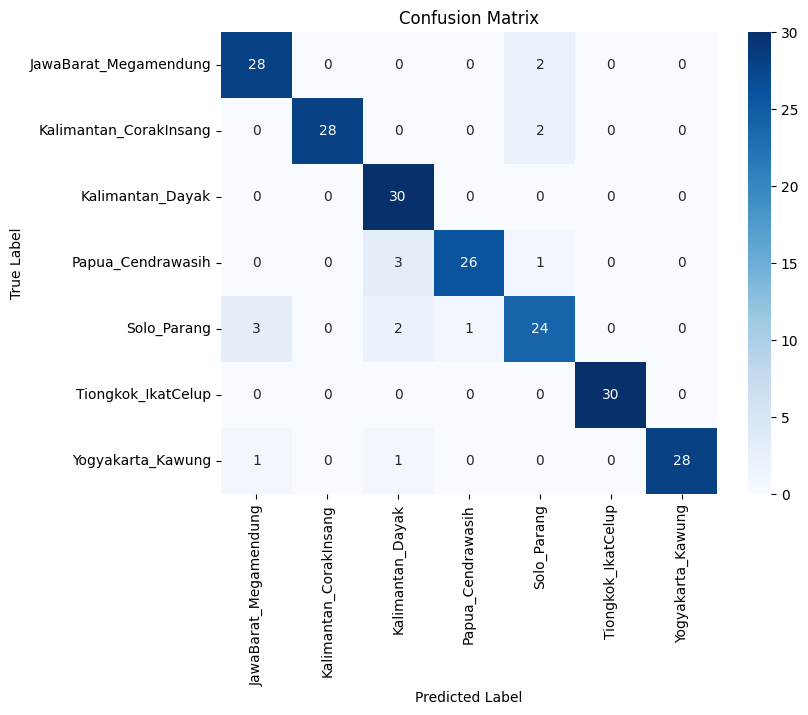

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.88      0.93      0.90        30
Kalimantan_CorakInsang       1.00      0.93      0.97        30
      Kalimantan_Dayak       0.83      1.00      0.91        30
     Papua_Cendrawasih       0.96      0.87      0.91        30
           Solo_Parang       0.83      0.80      0.81        30
    Tiongkok_IkatCelup       1.00      1.00      1.00        30
     Yogyakarta_Kawung       1.00      0.93      0.97        30

              accuracy                           0.92       210
             macro avg       0.93      0.92      0.92       210
          weighted avg       0.93      0.92      0.92       210



In [9]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Skenario_2.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_19480\3916101968.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


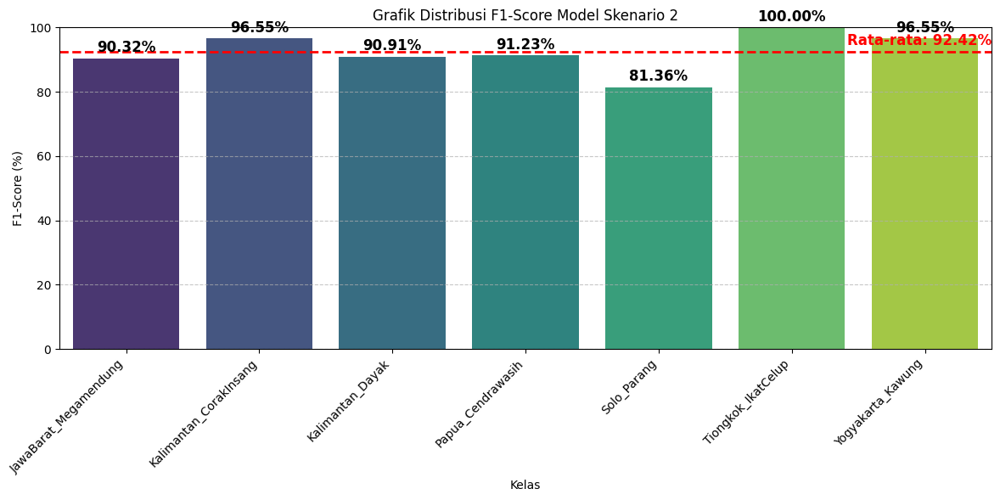

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model Skenario 2")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Skenario 3

7/7 ━━━━━━━━━━━━━━━━━━━━ 9s 1s/step  


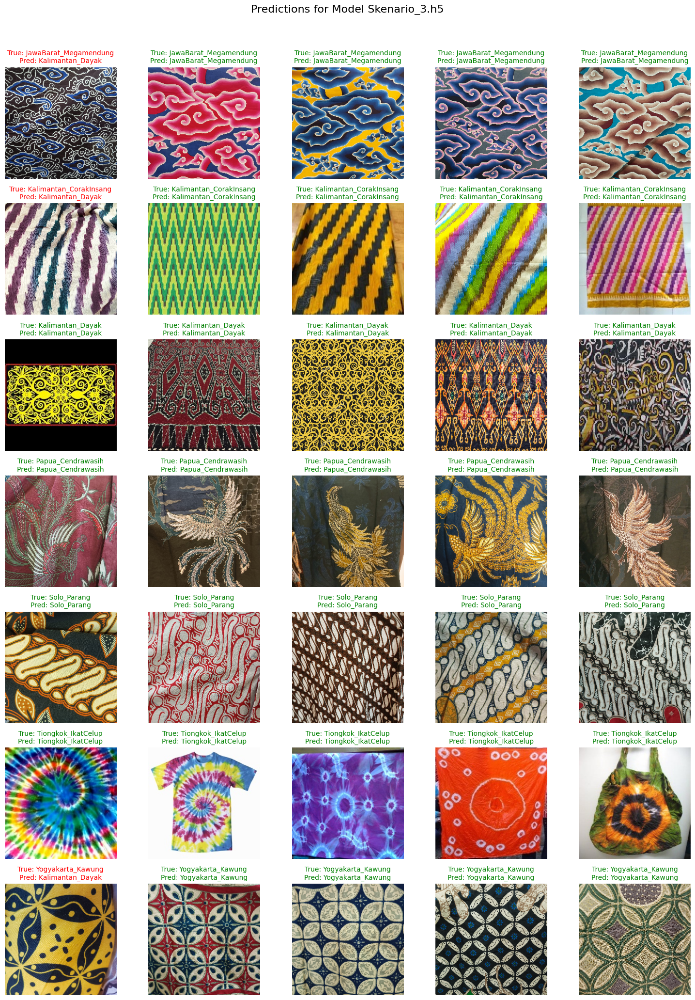

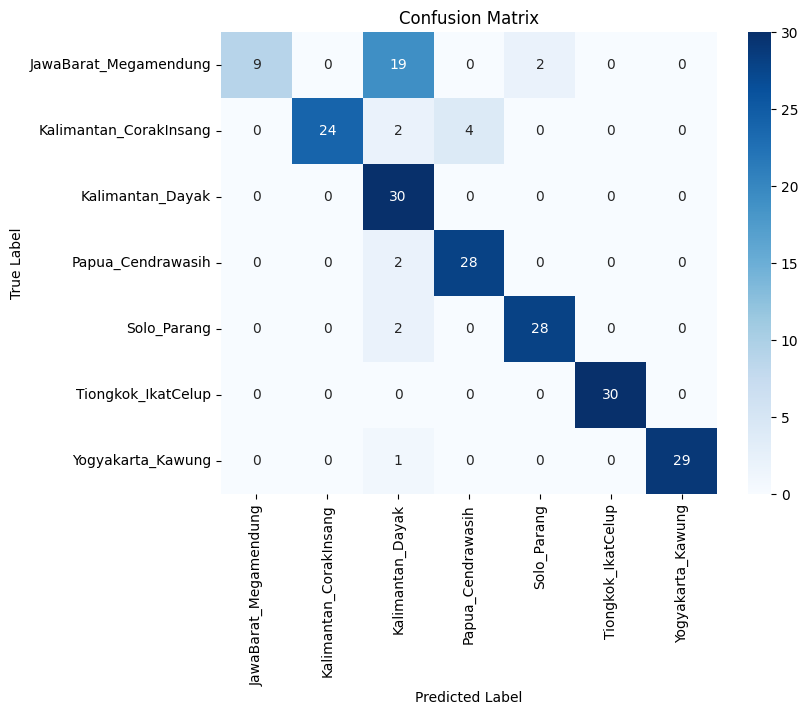

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       1.00      0.30      0.46        30
Kalimantan_CorakInsang       1.00      0.80      0.89        30
      Kalimantan_Dayak       0.54      1.00      0.70        30
     Papua_Cendrawasih       0.88      0.93      0.90        30
           Solo_Parang       0.93      0.93      0.93        30
    Tiongkok_IkatCelup       1.00      1.00      1.00        30
     Yogyakarta_Kawung       1.00      0.97      0.98        30

              accuracy                           0.85       210
             macro avg       0.91      0.85      0.84       210
          weighted avg       0.91      0.85      0.84       210



In [11]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Skenario_3.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_19480\1585726662.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


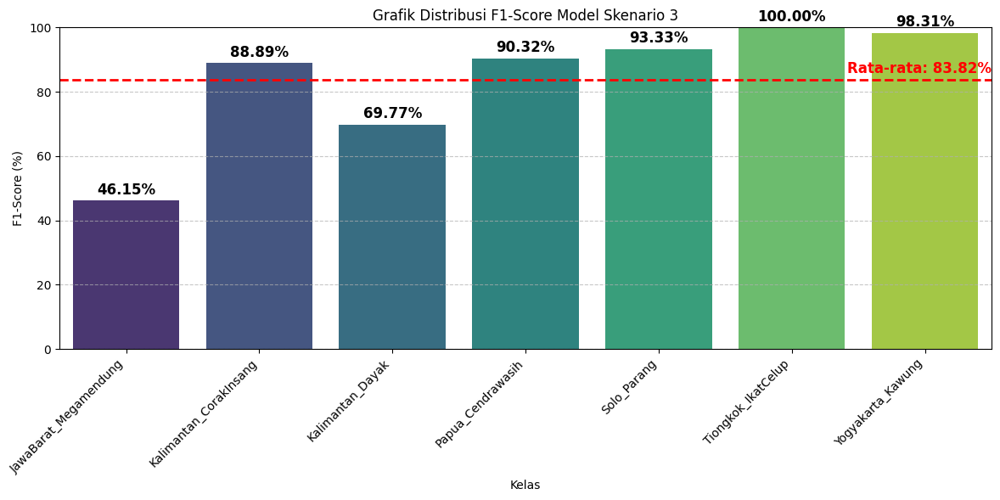

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model Skenario 3")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Skenario 4

7/7 ━━━━━━━━━━━━━━━━━━━━ 9s 1s/step  


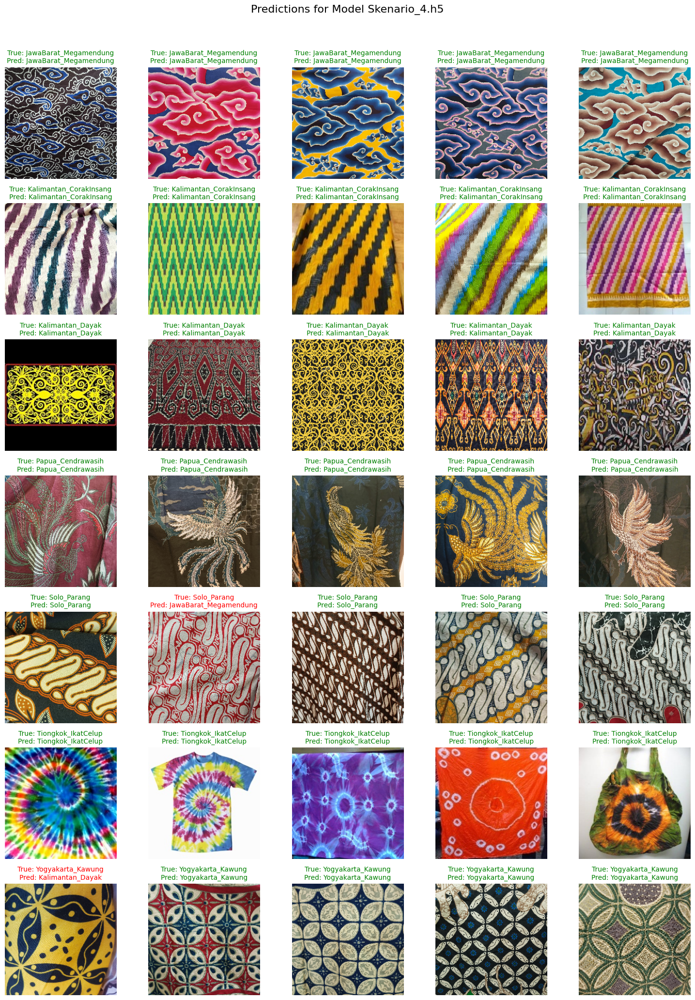

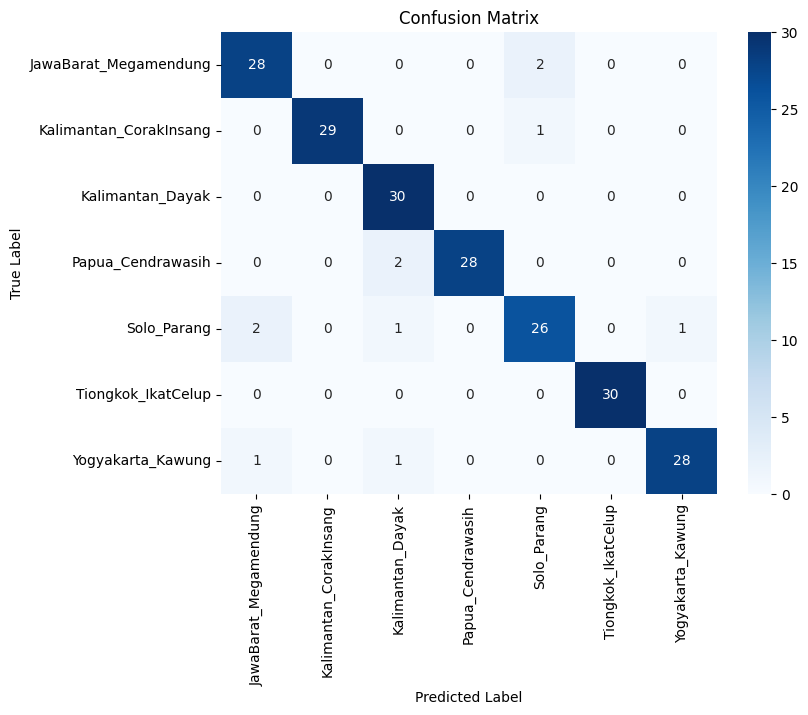

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.90      0.93      0.92        30
Kalimantan_CorakInsang       1.00      0.97      0.98        30
      Kalimantan_Dayak       0.88      1.00      0.94        30
     Papua_Cendrawasih       1.00      0.93      0.97        30
           Solo_Parang       0.90      0.87      0.88        30
    Tiongkok_IkatCelup       1.00      1.00      1.00        30
     Yogyakarta_Kawung       0.97      0.93      0.95        30

              accuracy                           0.95       210
             macro avg       0.95      0.95      0.95       210
          weighted avg       0.95      0.95      0.95       210



In [13]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Skenario_4.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_19480\151035079.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


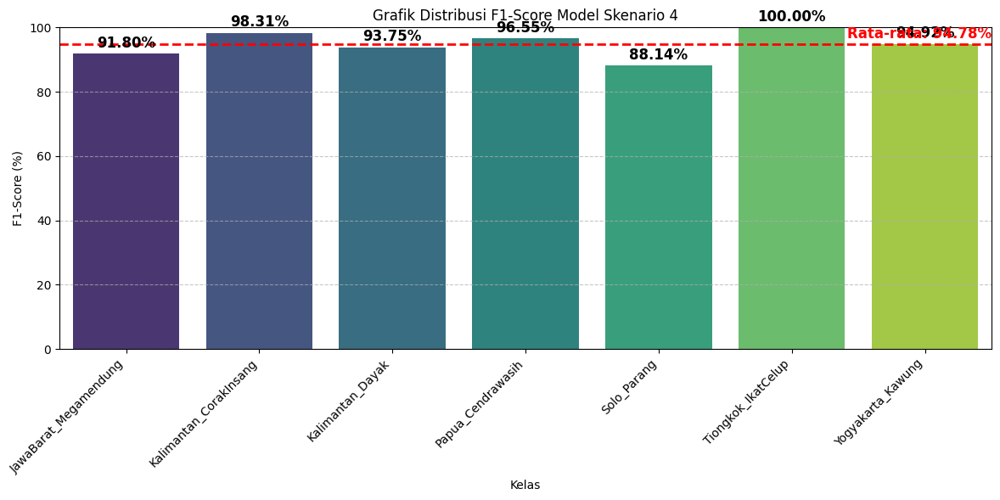

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model Skenario 4")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()
